### data exploration

Number of annotations: 5011
Number of images: 5011


C:\Users\H\AppData\Local\Temp\ipykernel_18296\3644463808.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(categories), y=list(counts), palette="viridis")


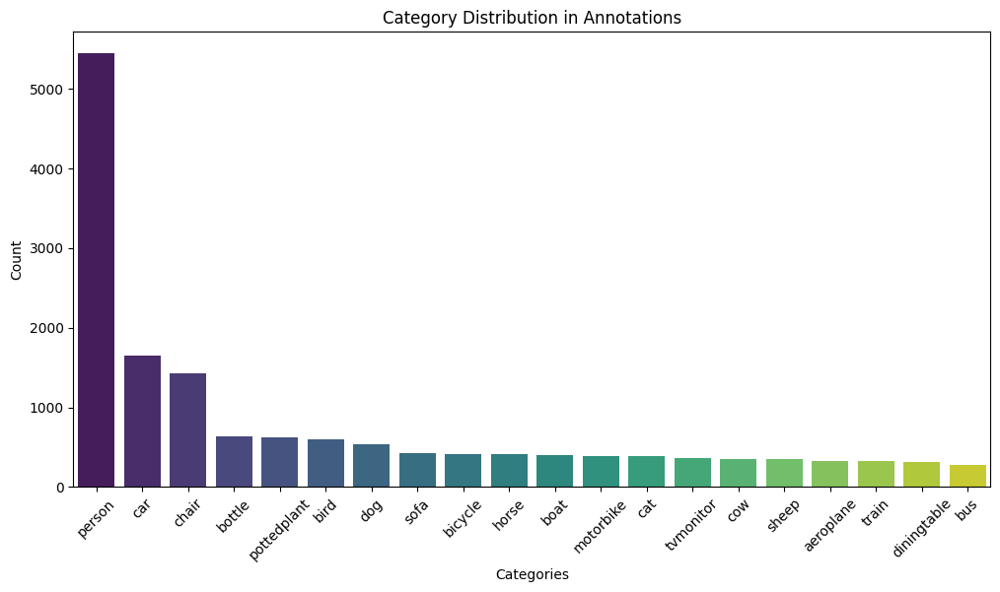

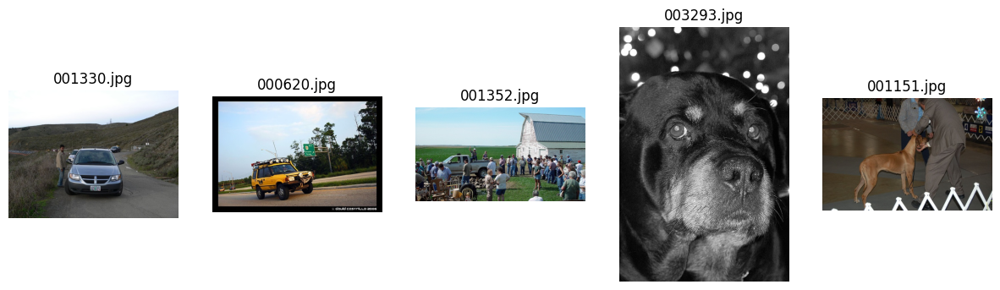

In [2]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import xml.etree.ElementTree as ET

# Define paths
base_path = "pascal_voc\VOCtrainval_06-Nov-2007\VOCdevkit\VOC2007"
annotations_path = os.path.join(base_path, "Annotations")
images_path = os.path.join(base_path, "JPEGImages")

# Count the number of annotations and images
num_annotations = len(os.listdir(annotations_path))
num_images = len(os.listdir(images_path))

print(f"Number of annotations: {num_annotations}")
print(f"Number of images: {num_images}")

# Parse XML files to extract object categories
categories = []
for file in os.listdir(annotations_path):
    if file.endswith(".xml"):
        tree = ET.parse(os.path.join(annotations_path, file))
        root = tree.getroot()
        for obj in root.findall("object"):
            category = obj.find("name").text
            categories.append(category)

# Count category occurrences
category_counts = Counter(categories)

# Convert to a sorted list for visualization
sorted_categories = sorted(category_counts.items(), key=lambda x: x[1], reverse=True)
categories, counts = zip(*sorted_categories)

# Plot category distribution
plt.figure(figsize=(12, 6))
sns.barplot(x=list(categories), y=list(counts), palette="viridis")
plt.title("Category Distribution in Annotations")
plt.xlabel("Categories")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

# Visualize a few images
import random
from PIL import Image

sample_images = random.sample(os.listdir(images_path), 5)
plt.figure(figsize=(15, 10))
for i, img_file in enumerate(sample_images):
    img_path = os.path.join(images_path, img_file)
    img = Image.open(img_path)
    plt.subplot(1, 5, i + 1)
    plt.imshow(img)
    plt.axis("off")
    plt.title(img_file)
plt.show()

In [ ]:
# pip install matplotlib opencv-python lxml tqdm


     ---------------------------------------- 3.8/3.8 MB 826.0 kB/s eta 0:00:00
     -------------------------------------- 78.5/78.5 KB 875.6 kB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
You should consider upgrading via the 'c:\Users\H\AppData\Local\Programs\Python\Python310\python.exe -m pip install --upgrade pip' command.


### annotation parser and image visualizer

In [175]:
import os
import xml.etree.ElementTree as ET
import matplotlib.pyplot as plt
import cv2
from collections import defaultdict
from tqdm import tqdm

# Set your dataset path here
VOC_ROOT = "pascal_voc\VOCtrainval_06-Nov-2007\VOCdevkit\VOC2007"
ANNOTATIONS_PATH = os.path.join(VOC_ROOT, "Annotations")
IMAGES_PATH = os.path.join(VOC_ROOT, "JPEGImages")

def parse_annotation(xml_file):
    tree = ET.parse(xml_file)
    root = tree.getroot()
    boxes = []
    labels = []

    for obj in root.findall('object'):
        name = obj.find('name').text
        labels.append(name)
        bbox = obj.find('bndbox')
        box = [
            int(bbox.find('xmin').text),
            int(bbox.find('ymin').text),
            int(bbox.find('xmax').text),
            int(bbox.find('ymax').text)
        ]
        boxes.append(box)
    
    filename = root.find('filename').text
    return filename, boxes, labels

def show_image_with_boxes(image_path, boxes, labels):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    for box, label in zip(boxes, labels):
        x1, y1, x2, y2 = box
        cv2.rectangle(image, (x1, y1), (x2, y2), color=(0, 255, 0), thickness=2)
        cv2.putText(image, label, (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.axis('off')
    plt.show()


step 2, visualizing random samples

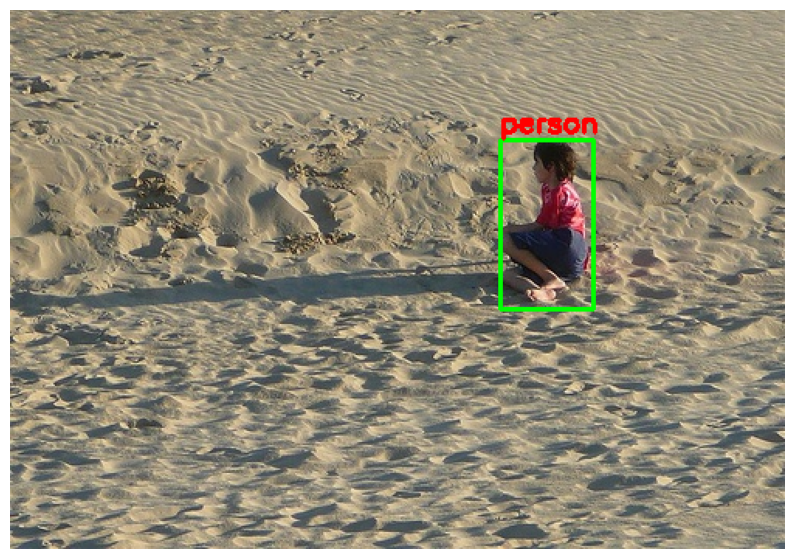

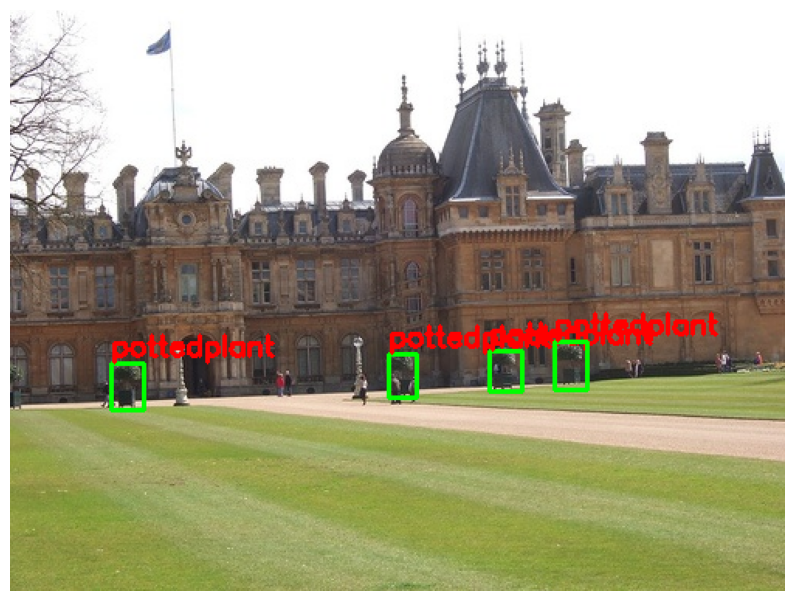

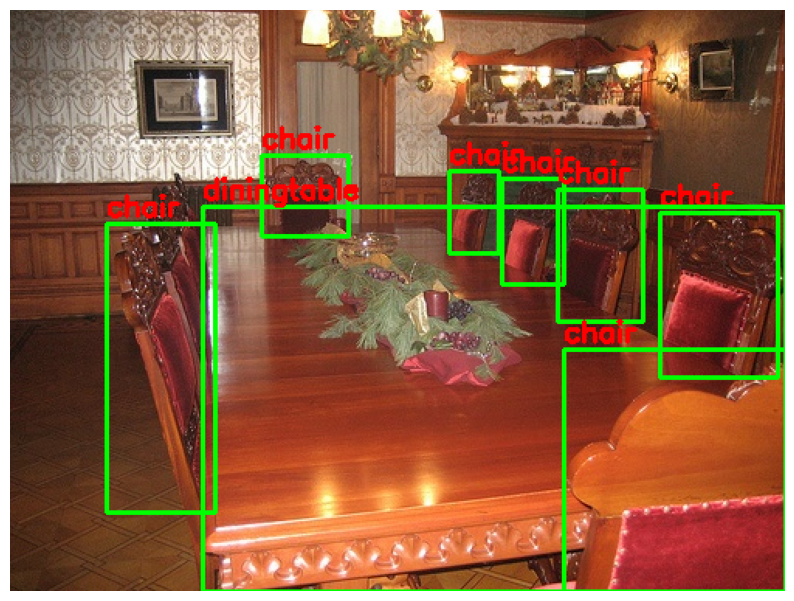

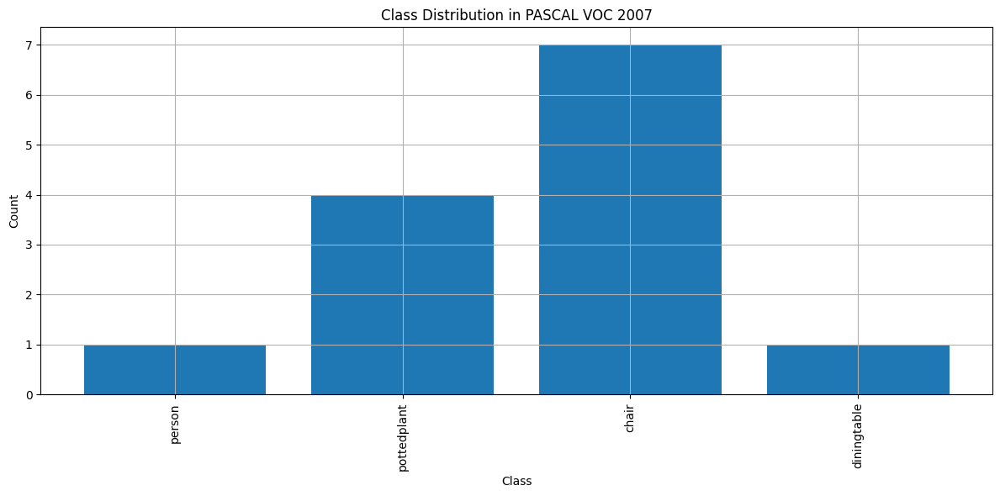

In [12]:
import random

# Get all annotation files
annotation_files = os.listdir(ANNOTATIONS_PATH)

# Store class frequency
class_counts = defaultdict(int)

# Show 3 random samples
for i in range(3):
    file = random.choice(annotation_files)
    xml_path = os.path.join(ANNOTATIONS_PATH, file)
    filename, boxes, labels = parse_annotation(xml_path)
    
    for label in labels:
        class_counts[label] += 1

    image_path = os.path.join(IMAGES_PATH, filename)
    show_image_with_boxes(image_path, boxes, labels)

# Plot class distribution
plt.figure(figsize=(12, 6))
plt.bar(class_counts.keys(), class_counts.values())
plt.xticks(rotation=90)
plt.title("Class Distribution in PASCAL VOC 2007")
plt.xlabel("Class")
plt.ylabel("Count")
plt.grid(True)
plt.tight_layout()
plt.show()


Secondly, Image Processing
We’ll implement the following:

Resizing images to a fixed shape (e.g., 224×224 for classification).

Normalization to scale pixel values between 0–1 or -1 to 1.

Data Augmentation (optional but useful):

Horizontal flip

Random crop

Color jitter

Rotation

now we install necessary libarary for preprocessing and Augmentation

In [ ]:
# pip install torch torchvision


     ------------------------------------ 212.5/212.5 MB 698.0 kB/s eta 0:00:00
     ---------------------------------------- 1.7/1.7 MB 642.5 kB/s eta 0:00:00
     ---------------------------------------- 6.3/6.3 MB 762.3 kB/s eta 0:00:00
     ------------------------------------ 134.9/134.9 KB 569.2 kB/s eta 0:00:00
     -------------------------------------- 194.4/194.4 KB 1.3 MB/s eta 0:00:00
     ------------------------------------ 536.2/536.2 KB 863.6 kB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
You should consider upgrading via the 'c:\Users\H\AppData\Local\Programs\Python\Python310\python.exe -m pip install --upgrade pip' command.


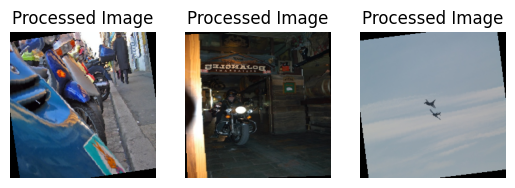

In [127]:
from torchvision import transforms
from PIL import Image

# Define preprocessing transformations
transform_basic = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),  # Converts to tensor and scales to [0, 1]
    transforms.Normalize(mean=[0.485, 0.456, 0.406],  # ImageNet mean/std
                         std=[0.229, 0.224, 0.225])
])

# Augmented version (for training only)
transform_augmented = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    # transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# Example: preprocess and show an image
def preprocess(image_path, transform):
    image = Image.open(image_path).convert('RGB')
    transformed = transform(image)

    # Convert tensor back to image for visualization
    img = transformed.permute(1, 2, 0).numpy()
    img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # Unnormalize
    img = img.clip(0, 1)
    return img

# Test it
sample_img = os.path.join(IMAGES_PATH, random.choice(os.listdir(IMAGES_PATH)))
img = preprocess(sample_img, transform_augmented)
# prep_img = preprocess(sample_img, transform_augmented)
for i in range(3):
    sample_img = os.path.join(IMAGES_PATH, random.choice(os.listdir(IMAGES_PATH)))
    img = preprocess(sample_img, transform_augmented)
    plt.subplot(1, 3, i + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Processed Image")

### Step 3: Feature Extraction
You'll try multiple techniques and later compare their effect on performance:

🔹 Option A: Traditional Features (No Deep Learning)
1. HOG (Histogram of Oriented Gradients)
Great for detecting shapes and edges, works well with classical ML models like SVM.

(np.float64(-0.5), np.float64(223.5), np.float64(223.5), np.float64(-0.5))

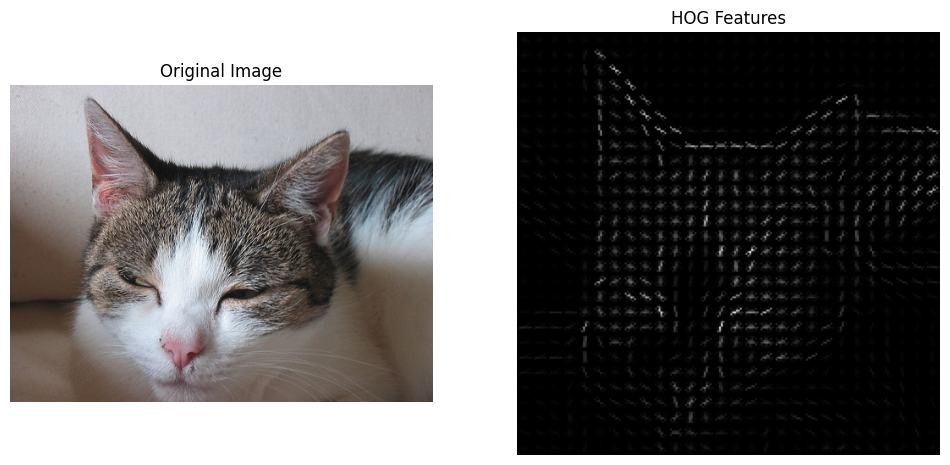

In [131]:
from skimage.feature import hog
from skimage import color
import cv2

def extract_hog_features(image_path):
    # Preprocess the image using the transform pipeline
    image = preprocess(image_path, transform_basic)  # Preprocessed tensor
    image_np = (image * 255).astype(np.uint8)  # Convert to NumPy array and scale to [0, 255]

    # Convert to grayscale
    gray = color.rgb2gray(image_np)

    # Extract HOG features
    features, hog_image = hog(
        gray, pixels_per_cell=(8, 8), cells_per_block=(2, 2),
        visualize=True
    )
    return image_np, hog_image

sample_img = os.path.join(IMAGES_PATH, random.choice(os.listdir(IMAGES_PATH)))

features, hog_image = extract_hog_features(sample_img)

image = cv2.imread(sample_img)

image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(image)
plt.title("Original Image")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(hog_image, cmap='gray')
plt.title("HOG Features")
plt.axis('off')

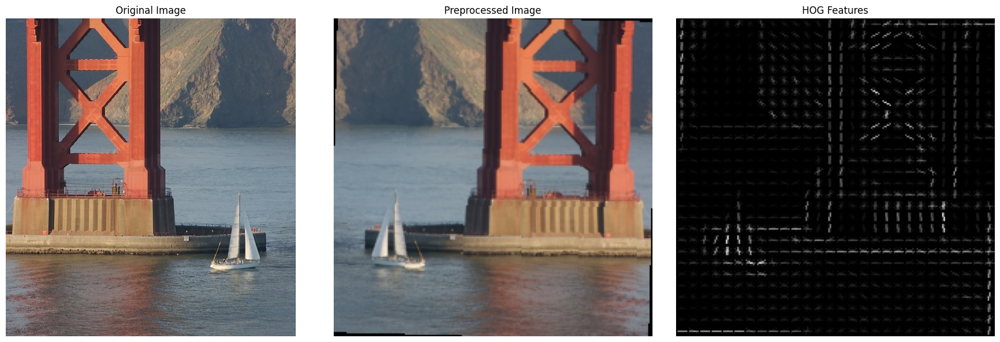

In [146]:
from skimage.feature import hog
from skimage import color
import cv2
import matplotlib.pyplot as plt
import os
import random

def extract_hog_features(image_path):
    # Preprocess the image using the transform pipeline
    image = preprocess(image_path, transform_augmented)  # Preprocessed tensor
    # Convert to grayscale
    gray = color.rgb2gray(image)

    # Extract HOG features
    features, hog_image = hog(
        gray, pixels_per_cell=(8, 8), cells_per_block=(2, 2),
        visualize=True
    )
    return image, hog_image

# Select a random image
sample_img = os.path.join(IMAGES_PATH, random.choice(os.listdir(IMAGES_PATH)))

# Extract features and images
preprocessed_image, hog_image = extract_hog_features(sample_img)

# Load the original image
original_image = cv2.imread(sample_img)
original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB

# Plot the original image, preprocessed image, and HOG features
plt.figure(figsize=(18, 6))

# Original image
plt.subplot(1, 3, 1)
plt.imshow(original_image)
plt.title("Original Image")
plt.axis('off')

# Preprocessed image
plt.subplot(1, 3, 2)
plt.imshow(preprocessed_image)
plt.title("Preprocessed Image")
plt.axis('off')

# HOG features
plt.subplot(1, 3, 3)
plt.imshow(hog_image, cmap='gray')
plt.title("HOG Features")
plt.axis('off')

plt.tight_layout()
plt.show()

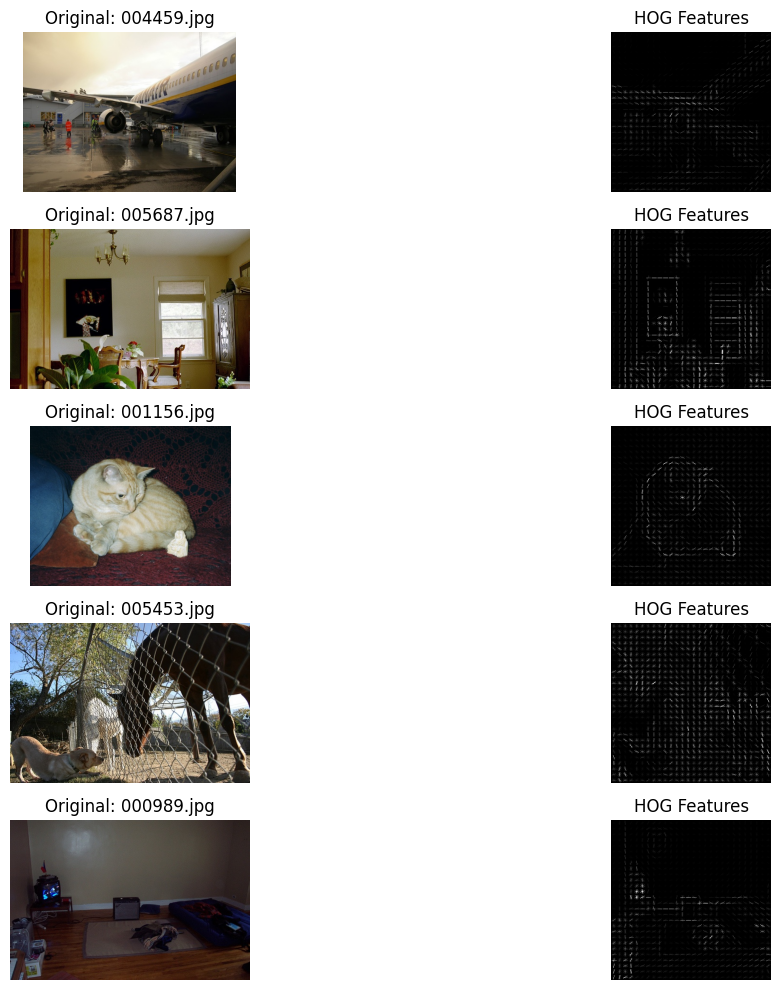

In [114]:
# Select 5 random images
num_images = 5
random_images = random.sample(os.listdir(IMAGES_PATH), num_images)

# Create a figure to display all images
plt.figure(figsize=(15, 10))

for i, img_name in enumerate(random_images, 1):
    img_path = os.path.join(IMAGES_PATH, img_name)
    
    # Load original image (for display)
    original_img = cv2.imread(img_path)
    original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
    
    # Extract HOG features
    processed_img, hog_img = extract_hog_features(img_path)
    
    # Plot original image
    plt.subplot(num_images, 2, 2*i - 1)
    plt.imshow(original_img)
    plt.title(f"Original: {img_name}")
    plt.axis('off')
    
    # Plot HOG image
    plt.subplot(num_images, 2, 2*i)
    plt.imshow(hog_img, cmap='gray')
    plt.title("HOG Features")
    plt.axis('off')

plt.tight_layout()
plt.show()

# **SIFT**

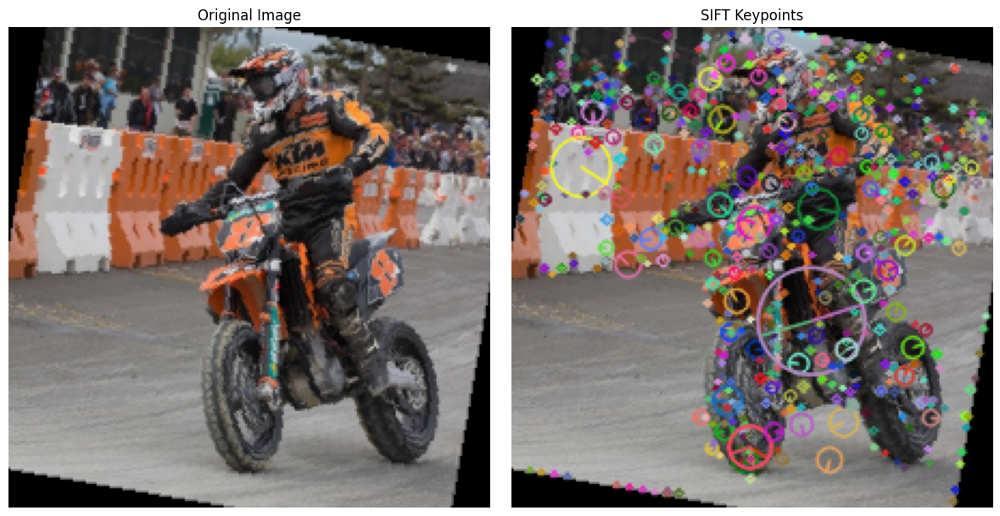

In [168]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms
transform_augmented = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    # transforms.HorizontalFlip(),
    transforms.RandomRotation(20),
    transforms.ToTensor(),
    # transforms.Normalize(mean=[0.485, 0.456, 0.406],
    #                      std=[0.229, 0.224, 0.225])
])
# Reuse your existing transform
def extract_sift_features(image_path):
    image_np = preprocess(image_path, transform_augmented)  # Preprocessed tensor

    # Convert to grayscale
    gray = cv2.cvtColor(image_np, cv2.COLOR_RGB2GRAY)

    # SIFT feature extractor
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(gray, None)

    # Draw keypoints on the image
    sift_image = cv2.drawKeypoints(image_np, keypoints, None,
                                   flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    return image_np, sift_image

# Example usage
sample_img = os.path.join(IMAGES_PATH, random.choice(os.listdir(IMAGES_PATH)))

original_img, sift_image = extract_sift_features(sample_img)

# Plot results
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(original_img)
plt.title("Original Image")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(sift_image)
plt.title("SIFT Keypoints")
plt.axis('off')

plt.tight_layout()
plt.show()


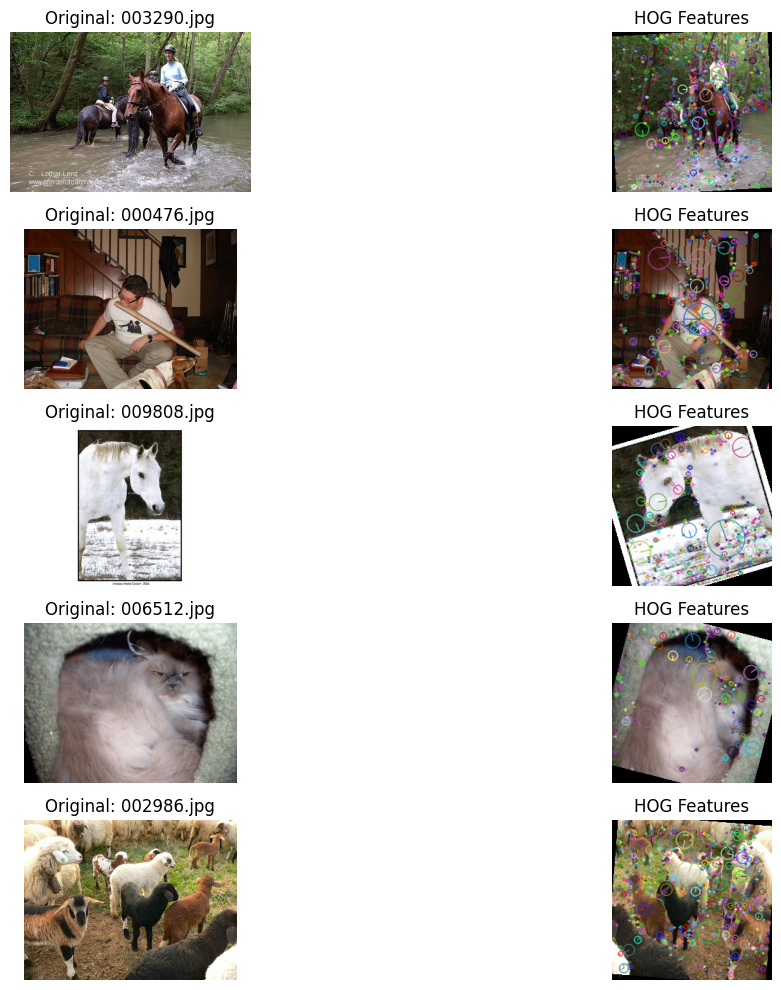

In [169]:
num_images = 5
random_images = random.sample(os.listdir(IMAGES_PATH), num_images)

# Create a figure to display all images
plt.figure(figsize=(15, 10))

for i, img_name in enumerate(random_images, 1):
    img_path = os.path.join(IMAGES_PATH, img_name)
    
    # Load original image (for display)
    original_img = cv2.imread(img_path)
    original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
    
    # Extract HOG features
    processed_img, hog_img = extract_sift_features(img_path)
    
    # Plot original image
    plt.subplot(num_images, 2, 2*i - 1)
    plt.imshow(original_img)
    plt.title(f"Original: {img_name}")
    plt.axis('off')
    
    # Plot HOG image
    plt.subplot(num_images, 2, 2*i)
    plt.imshow(hog_img, cmap='gray')
    plt.title("HOG Features")
    plt.axis('off')

plt.tight_layout()
plt.show()

## Lets extract the features and train models

In [170]:
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import classification_report
import os

def extract_dataset_features(feature_extractor, image_paths, labels):
    features = []
    for img_path in image_paths:
        try:
            _, f_img = feature_extractor(img_path)
            features.append(f_img.flatten())  # Flatten HOG or SIFT
        except:
            continue
    return np.array(features), np.array(labels)


In [176]:
# Example: Load a few images per class from the VOC dataset
from xml.etree import ElementTree as ET

def get_image_paths_and_labels(limit_per_class=50):
    VOC_ROOT = "pascal_voc\VOCtrainval_06-Nov-2007\VOCdevkit\VOC2007"
    # annotations_dir = os.path.join(VOC_ROOT, 'pascal_voc\VOCtrainval_06-Nov-2007\VOCdevkit\VOC2007\Annotations')
    # images_dir = os.path.join(VOC_ROOT, 'pascal_voc\VOCtrainval_06-Nov-2007\VOCdevkit\VOC2007\JPEGImagesages')
    annotations_dir = os.path.join(VOC_ROOT, "Annotations")
    images_dir = os.path.join(VOC_ROOT, "JPEGImages")
    class_map = {'dog': 0, 'car': 1, 'person': 2}
    data = {k: [] for k in class_map.keys()}

    for xml_file in os.listdir(annotations_dir):
        xml_path = os.path.join(annotations_dir, xml_file)
        tree = ET.parse(xml_path)
        root = tree.getroot()
        image_name = root.find('filename').text
        image_path = os.path.join(images_dir, image_name)

        for obj in root.findall('object'):
            class_name = obj.find('name').text
            if class_name in class_map and len(data[class_name]) < limit_per_class:
                data[class_name].append(image_path)
                break

    all_paths, all_labels = [], []
    for class_name, paths in data.items():
        all_paths.extend(paths)
        all_labels.extend([class_map[class_name]] * len(paths))

    return all_paths, all_labels

image_paths, labels = get_image_paths_and_labels()


In [177]:
# Feature extraction
X, y = extract_dataset_features(extract_hog_features, image_paths, labels)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train SVM
clf = SVC(kernel='linear')
clf.fit(X_train, y_train)

# Evaluate
y_pred = clf.predict(X_test)
print(classification_report(y_test, y_pred, target_names=['dog', 'car', 'person']))


              precision    recall  f1-score   support

         dog       0.53      0.90      0.67        10
         car       0.88      0.78      0.82         9
      person       0.80      0.36      0.50        11

    accuracy                           0.67        30
   macro avg       0.73      0.68      0.66        30
weighted avg       0.73      0.67      0.65        30



In [178]:
import matplotlib.pyplot as plt

# Class label mapping (same as before)
class_names = ['dog', 'car', 'person']

def plot_predictions(image_paths, true_labels, predicted_labels, num_samples=12):
    plt.figure(figsize=(16, 10))
    indices = np.random.choice(len(image_paths), size=num_samples, replace=False)

    for i, idx in enumerate(indices):
        img_path = image_paths[idx]
        true_label = class_names[true_labels[idx]]
        pred_label = class_names[predicted_labels[idx]]

        image = preprocess(img_path, transform_basic)

        plt.subplot(3, 4, i + 1)
        plt.imshow(image)
        plt.title(f"True: {true_label} | Pred: {pred_label}",
                  color='green' if true_label == pred_label else 'red')
        plt.axis('off')

    plt.tight_layout()
    plt.show()


In [179]:
plot_predictions(image_paths=X_test_paths,  # subset of paths matching X_test
                 true_labels=y_test,
                 predicted_labels=y_pred)


NameError: name 'X_test_paths' is not defined

              precision    recall  f1-score   support

         dog       0.58      0.64      0.61        22
         car       0.65      0.62      0.63        21
      person       0.50      0.47      0.48        17

    accuracy                           0.58        60
   macro avg       0.58      0.58      0.58        60
weighted avg       0.58      0.58      0.58        60



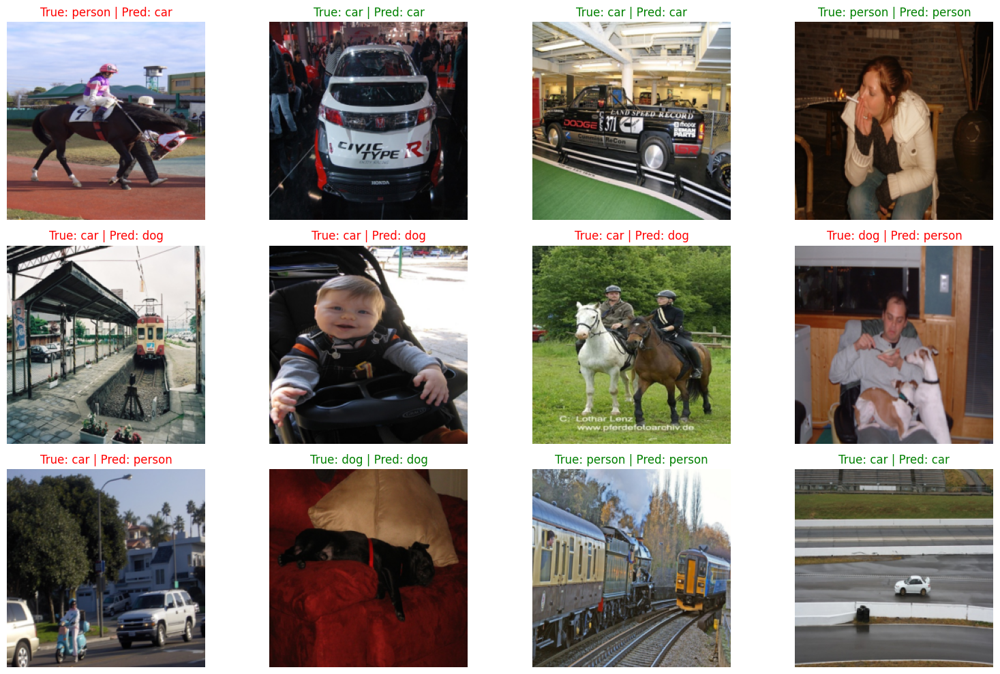

In [188]:
import os
import random
import numpy as np
import matplotlib.pyplot as plt
import cv2
import xml.etree.ElementTree as ET
from skimage.feature import hog
from skimage import color
from PIL import Image
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from torchvision import transforms

# ---------------------------------------------
# 1. Configuration
# ---------------------------------------------
# Modify this path to match your root dataset location
DATA_ROOT = "pascal_voc\VOCtrainval_06-Nov-2007\VOCdevkit\VOC2007"
ANNOTATIONS_PATH = os.path.join(DATA_ROOT, "Annotations")
IMAGES_PATH = os.path.join(DATA_ROOT, "JPEGImages")

# VOC_ROOT = "pascal_voc\VOCtrainval_06-Nov-2007\VOCdevkit\VOC2007"
# ANNOTATIONS_PATH = os.path.join(VOC_ROOT, "Annotations")
# IMAGES_PATH = os.path.join(VOC_ROOT, "JPEGImages")

class_map = {"dog": 0, "car": 1, "person": 2}
class_names = list(class_map.keys())

# ---------------------------------------------
# 2. Preprocessing & Feature Extraction
# ---------------------------------------------
transform_basic = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])

def preprocess(image_path, transform):
    image = Image.open(image_path).convert('RGB')
    image_tensor = transform(image)
    image_np = image_tensor.permute(1, 2, 0).numpy()  # (H, W, C)
    image_np = (image_np * 255).astype(np.uint8)
    return image_np

def extract_hog_features(image_np):
    gray = color.rgb2gray(image_np)
    features, _ = hog(gray, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True)
    return features

# ---------------------------------------------
# 3. Data Preparation (Images + Labels)
# ---------------------------------------------
def load_labeled_images(limit_per_class=100):
    data_paths, labels = [], []
    counts = {cls: 0 for cls in class_map}

    for xml_file in os.listdir(ANNOTATIONS_PATH):
        xml_path = os.path.join(ANNOTATIONS_PATH, xml_file)
        tree = ET.parse(xml_path)
        root = tree.getroot()
        filename = root.find("filename").text
        img_path = os.path.join(IMAGES_PATH, filename)

        for obj in root.findall("object"):
            class_name = obj.find("name").text
            if class_name in class_map and counts[class_name] < limit_per_class:
                data_paths.append(img_path)
                labels.append(class_map[class_name])
                counts[class_name] += 1
                break  # one class per image

        if all(c >= limit_per_class for c in counts.values()):
            break

    return data_paths, labels

# ---------------------------------------------
# 4. Load data and extract features
# ---------------------------------------------
image_paths, labels = load_labeled_images(limit_per_class=100)

X = []
for path in image_paths:
    try:
        img_np = preprocess(path, transform_basic)
        feat = extract_hog_features(img_np)
        X.append(feat)
    except:
        continue

X = np.array(X)
y = np.array(labels)

# ---------------------------------------------
# 5. Train/Test Split and Model Training
# ---------------------------------------------
X_train, X_test, y_train, y_test, path_train, path_test = train_test_split(
    X, y, image_paths, test_size=0.2, random_state=42
)

clf = SVC(kernel='linear')
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

print(classification_report(y_test, y_pred, target_names=class_names))

# ---------------------------------------------
# 6. Visualize Predictions
# ---------------------------------------------
def plot_predictions(paths, y_true, y_pred, num_samples=12):
    plt.figure(figsize=(16, 10))
    indices = np.random.choice(len(paths), size=num_samples, replace=False)

    for i, idx in enumerate(indices):
        path = paths[idx]
        true_label = class_names[y_true[idx]]
        pred_label = class_names[y_pred[idx]]

        img = preprocess(path, transform_basic)

        plt.subplot(3, 4, i + 1)
        plt.imshow(img)
        plt.title(f"True: {true_label} | Pred: {pred_label}",
                  color='green' if true_label == pred_label else 'red')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

plot_predictions(path_test, y_test, y_pred)


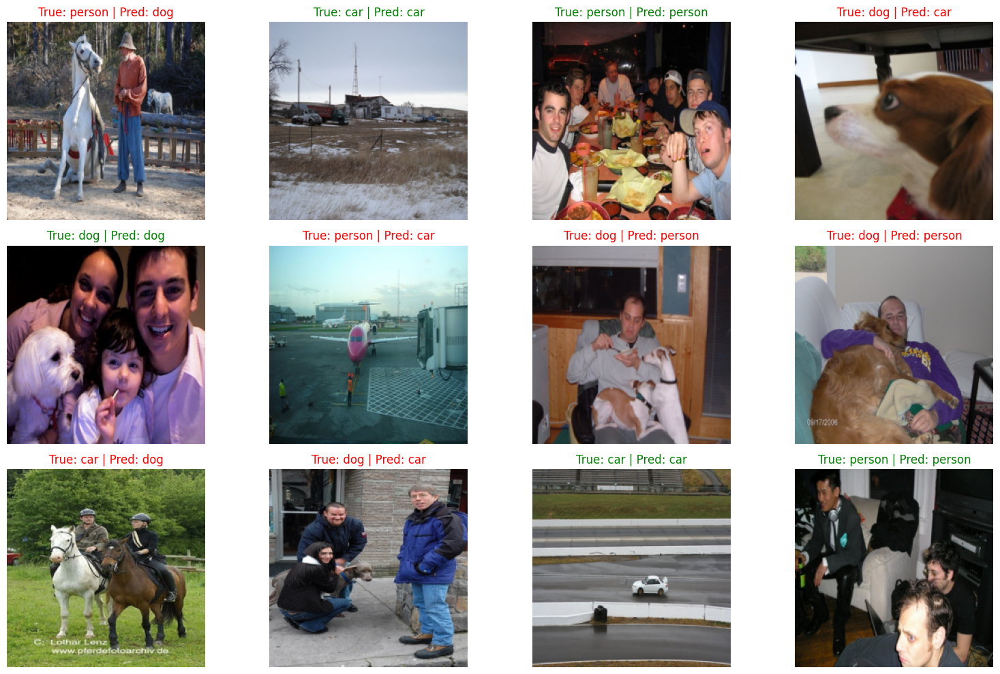

In [191]:
def plot_predictions(paths, y_true, y_pred, num_samples=12):
    plt.figure(figsize=(16, 10))
    indices = np.random.choice(len(paths), size=num_samples, replace=False)

    for i, idx in enumerate(indices):
        path = paths[idx]
        true_label = class_names[y_true[idx]]
        pred_label = class_names[y_pred[idx]]

        img = preprocess(path, transform_basic)

        plt.subplot(3, 4, i + 1)
        plt.imshow(img)
        plt.title(f"True: {true_label} | Pred: {pred_label}",
                  color='green' if true_label == pred_label else 'red')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

plot_predictions(path_test, y_test, y_pred)

# Object Detection and recognition

In [1]:
import os
import random
import cv2
import torch
import torchvision
import xml.etree.ElementTree as ET
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from torchvision import transforms
from PIL import Image

In [2]:
DATA_ROOT = "pascal_voc/VOCtest_06-Nov-2007/VOCdevkit/VOC2007"
IMAGES_PATH = os.path.join(DATA_ROOT, "JPEGImages")
ANNOTATIONS_PATH = os.path.join(DATA_ROOT, "Annotations")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [3]:
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
model = model.to(device)
model.eval()


c:\Users\H\AppData\Local\Programs\Python\Python310\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\H\AppData\Local\Programs\Python\Python310\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [4]:
VOC_CLASSES = [
    'aeroplane', 'bicycle', 'bird', 'boat', 'bottle',
    'bus', 'car', 'cat', 'chair', 'cow', 'diningtable',
    'dog', 'horse', 'motorbike', 'person', 'pottedplant',
    'sheep', 'sofa', 'train', 'tvmonitor'
]


In [5]:
def parse_voc_annotation(xml_file):
    tree = ET.parse(xml_file)
    root = tree.getroot()
    boxes, labels = [], []

    for obj in root.findall("object"):
        label = obj.find("name").text
        if label in VOC_CLASSES:
            label_idx = VOC_CLASSES.index(label)
            bbox = obj.find("bndbox")
            box = [
                int(bbox.find("xmin").text),
                int(bbox.find("ymin").text),
                int(bbox.find("xmax").text),
                int(bbox.find("ymax").text)
            ]
            boxes.append(box)
            labels.append(label_idx)
    return boxes, labels


In [6]:
transform = transforms.Compose([
    transforms.ToTensor()
])


In [7]:
def visualize_detections(image_path, gt_boxes, gt_labels, pred_boxes, pred_labels, pred_scores, threshold=0.5):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    fig, ax = plt.subplots(1, figsize=(10, 8))
    ax.imshow(image)

    # Ground truth: red boxes
    for box, label in zip(gt_boxes, gt_labels):
        xmin, ymin, xmax, ymax = box
        rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
        ax.text(xmin, ymin - 5, f"GT: {VOC_CLASSES[label]}", color='red', fontsize=10)

    # Predictions: green boxes
    for box, label, score in zip(pred_boxes, pred_labels, pred_scores):
        if score >= threshold:
            xmin, ymin, xmax, ymax = box
            rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='g', facecolor='none')
            ax.add_patch(rect)
            ax.text(xmin, ymax + 15, f"Pred: {VOC_CLASSES[label]} {score:.2f}", color='green', fontsize=10)

    plt.axis("off")
    plt.show()


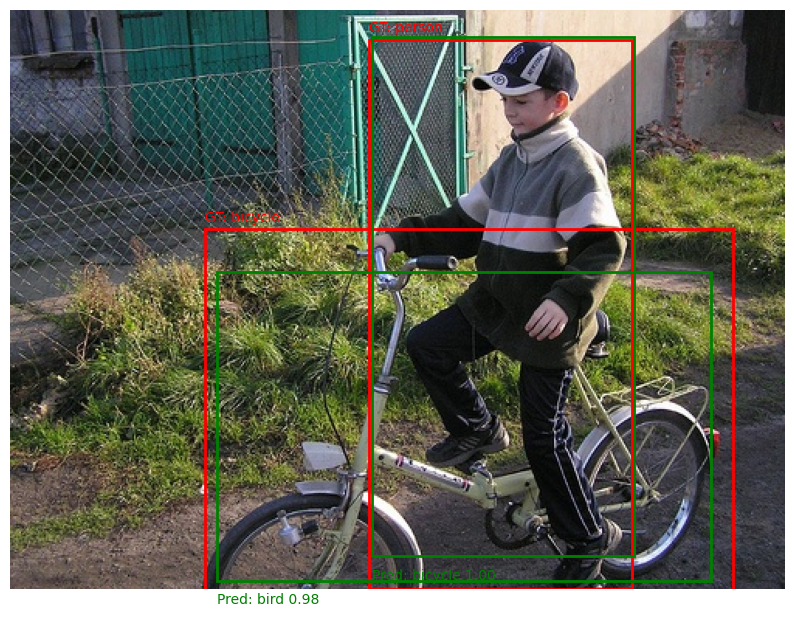

In [8]:
# Pick random image
sample_file = random.choice(os.listdir(ANNOTATIONS_PATH))
sample_image = sample_file.replace(".xml", ".jpg")

image_path = os.path.join(IMAGES_PATH, sample_image)
xml_path = os.path.join(ANNOTATIONS_PATH, sample_file)

# Ground truth
gt_boxes, gt_labels = parse_voc_annotation(xml_path)

# Preprocess and Predict
image = Image.open(image_path).convert("RGB")
image_tensor = transform(image).to(device)
with torch.no_grad():
    output = model([image_tensor])[0]

pred_boxes = output['boxes'].cpu().numpy().astype(int)
pred_labels = output['labels'].cpu().numpy()
pred_scores = output['scores'].cpu().numpy()

# Visualize
visualize_detections(image_path, gt_boxes, gt_labels, pred_boxes, pred_labels, pred_scores)


Prediction 1


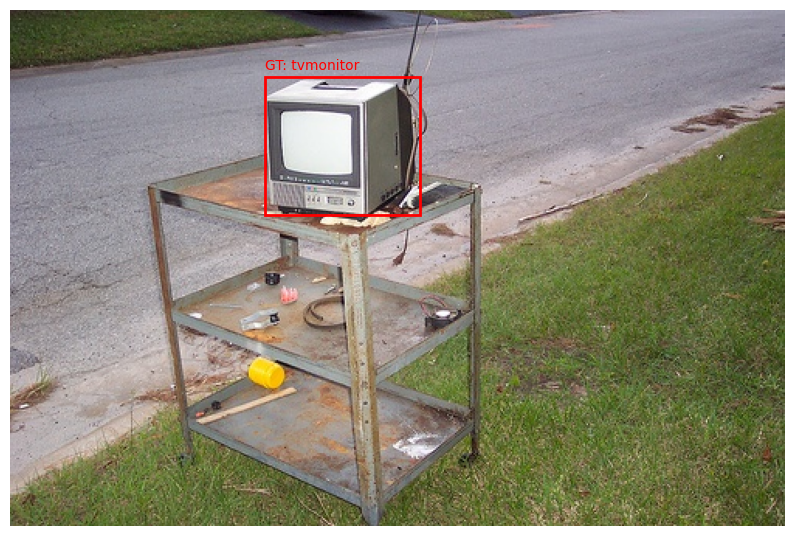

Prediction 2


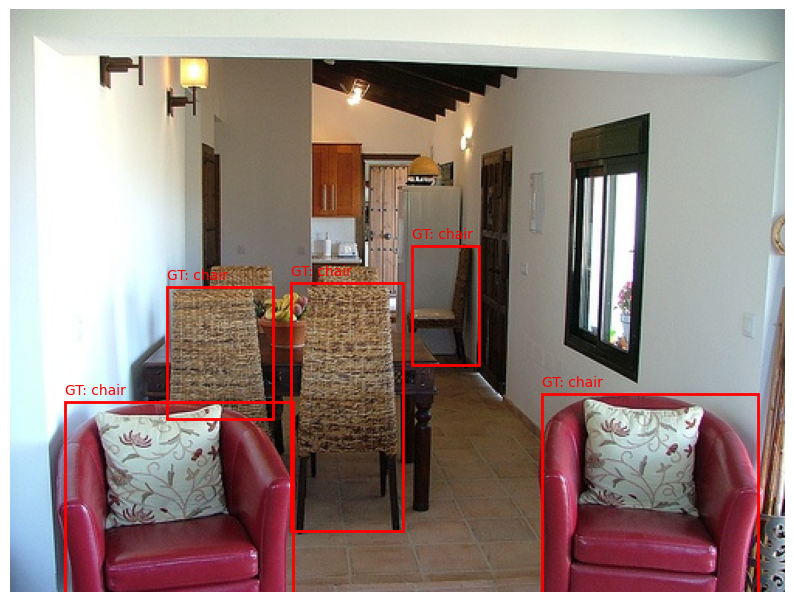

Prediction 3


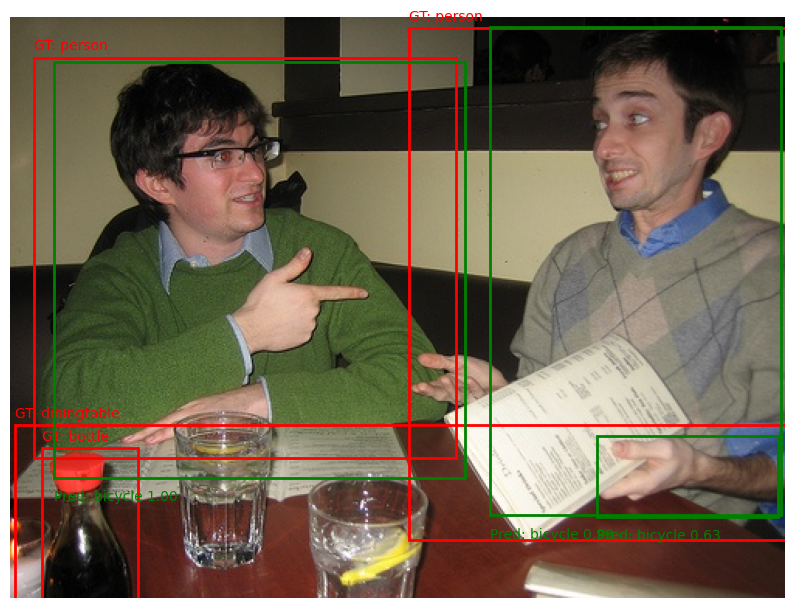

Prediction 4


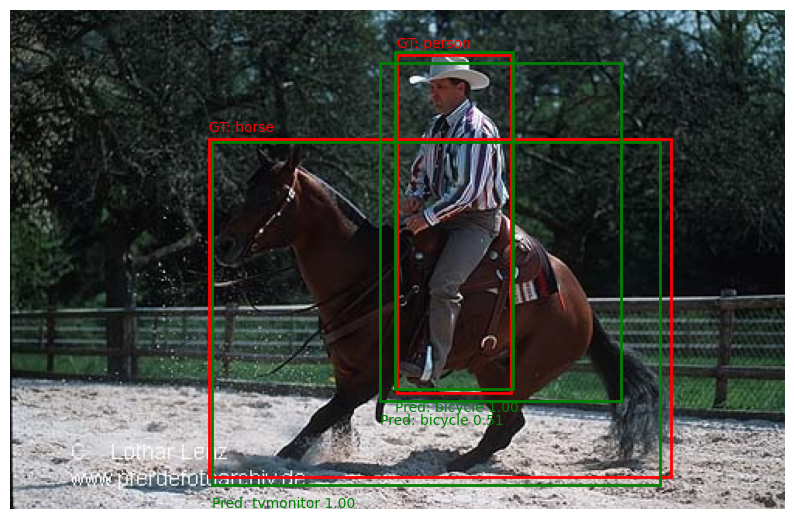

Prediction 5


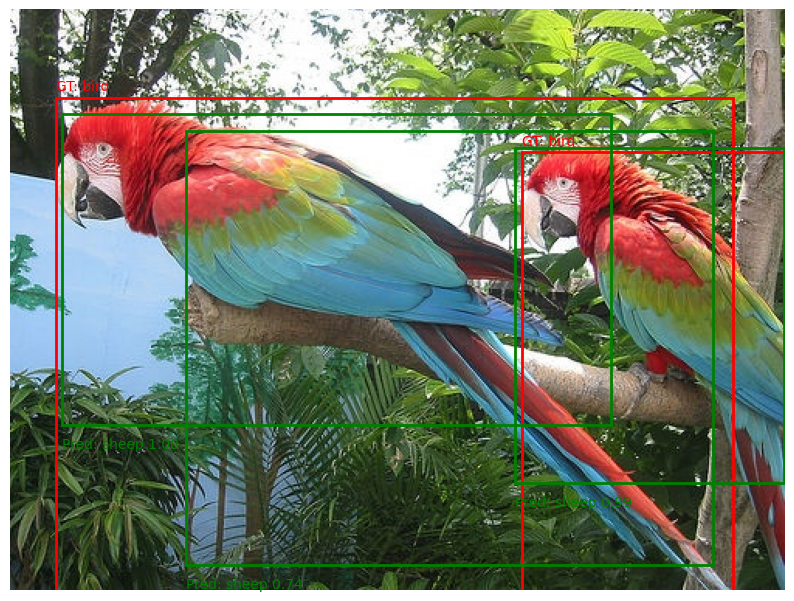

Prediction 6


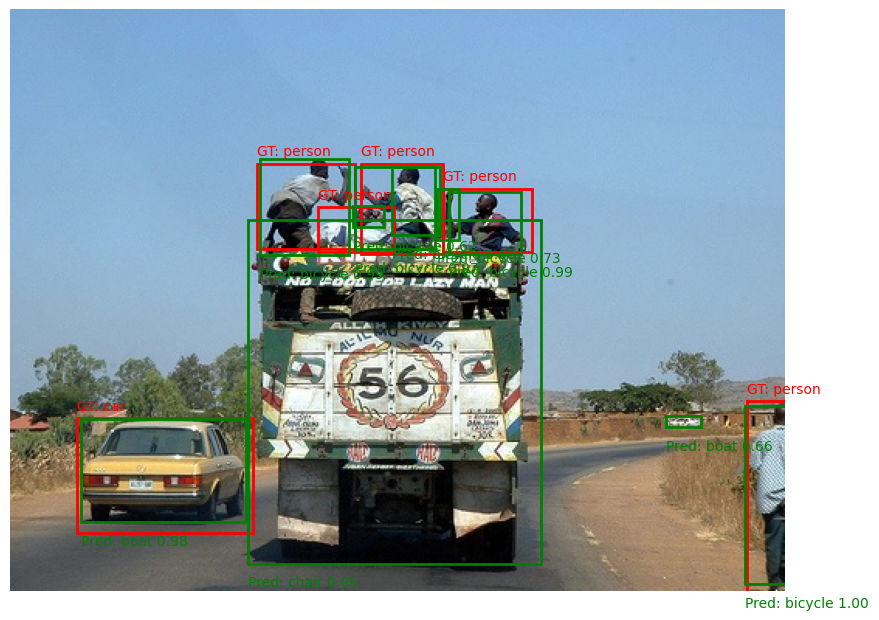

Prediction 7


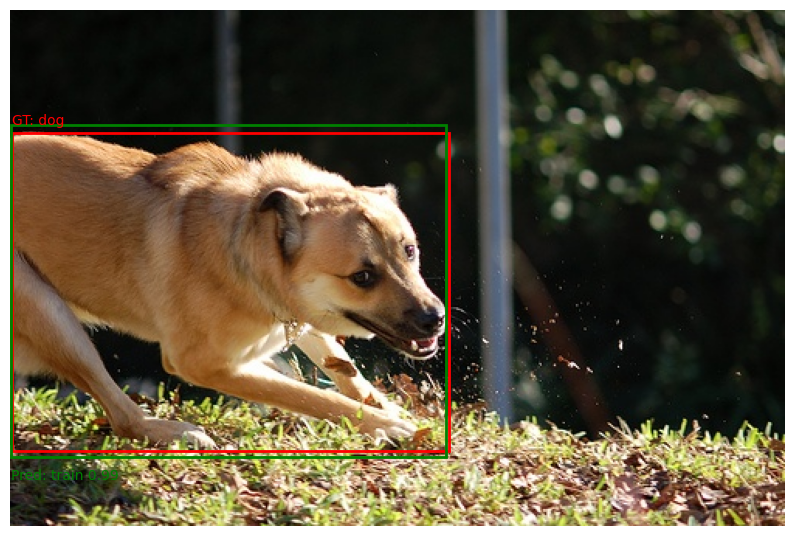

Prediction 8


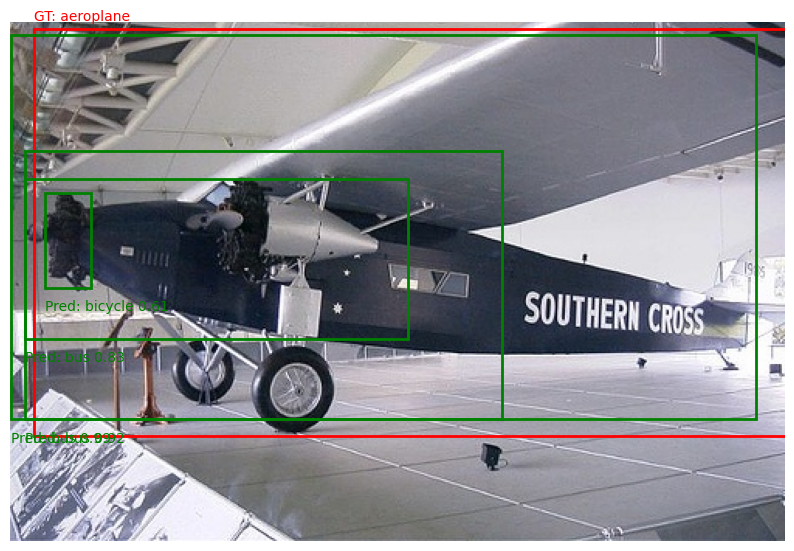

Prediction 9


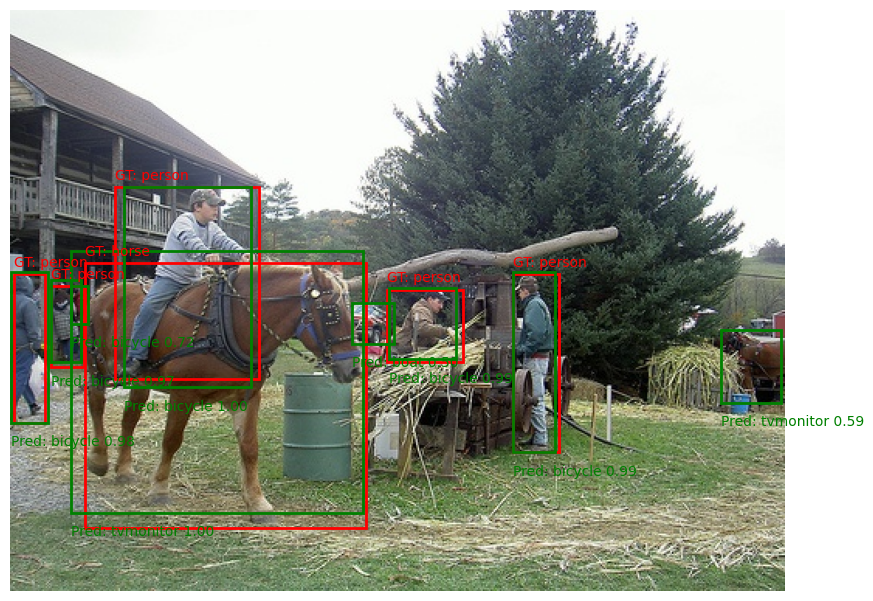

Prediction 10


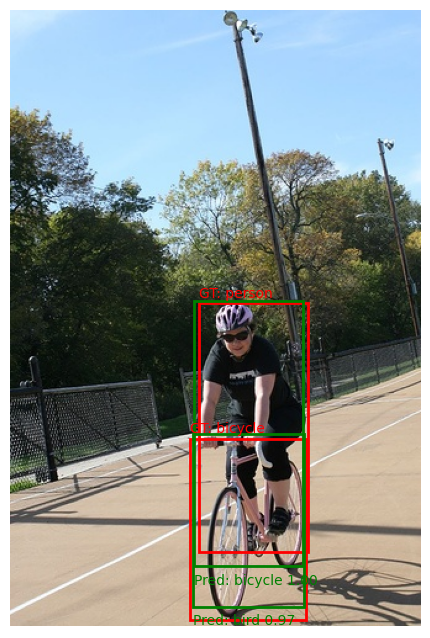

In [12]:
# Make 10 predictions
for i in range(10):
    print(f"Prediction {i + 1}")
    
    # Pick random image
    sample_file = random.choice(os.listdir(ANNOTATIONS_PATH))
    sample_image = sample_file.replace(".xml", ".jpg")

    image_path = os.path.join(IMAGES_PATH, sample_image)
    xml_path = os.path.join(ANNOTATIONS_PATH, sample_file)

    # Ground truth
    gt_boxes, gt_labels = parse_voc_annotation(xml_path)

    # Preprocess and Predict
    image = Image.open(image_path).convert("RGB")
    image_tensor = transform(image).to(device)
    with torch.no_grad():
        output = model([image_tensor])[0]

    pred_boxes = output['boxes'].cpu().numpy().astype(int)
    pred_labels = output['labels'].cpu().numpy()
    pred_scores = output['scores'].cpu().numpy()

    # Filter predictions with valid labels
    valid_indices = [i for i, label in enumerate(pred_labels) if label < len(VOC_CLASSES)]
    pred_boxes = pred_boxes[valid_indices]
    pred_labels = pred_labels[valid_indices]
    pred_scores = pred_scores[valid_indices]

    # Visualize
    visualize_detections(image_path, gt_boxes, gt_labels, pred_boxes, pred_labels, pred_scores)